In [ ]:
#!pip install pandas

Импортируем библиотеку Pandas в ноутбук

In [2]:
from statsmodels.tsa.api import adfuller
import pandas as pd
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt

# Стандартизатор признаков
from sklearn.preprocessing import StandardScaler

# Проверка на стационарность ряда данных
from statsmodels.tsa.stattools import adfuller

# Проверка на автокорреляцию
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

# Модельки
from statsmodels.tsa.arima.model import ARIMA
from sklearn.ensemble import IsolationForest


plt.style.use("seaborn-v0_8")
pd.set_option("display.max_columns", 200)
pd.set_option("display.width", 120)

# Создание дата-фрейма

---



Создаем переменную содержащую .csv

In [3]:
CS = '/content/CS_1.csv'

Создаем дата-фрейм на основе .csv файла

In [5]:
data_cs = pd.read_csv(CS)

data_cs

,Date&time,N2,N1,P2,T1,N3,Qtg,V1,VoГГ,3.77F2,Fтк4,3F2,Tк.з.,Lm1,T638,V2,ТРК,dPfgo,dPf2,dPf1,T607,T606,T600,Рс2,Рс1,Fc2,F2,3F1,Fc3,F1,Pm,P615,2F2,Fкпа,Fцс,Fc4,2F1,T4ср
0,05.01.2021 07:00:00,11927,9259,15.42,-3.7,4950,4836,3.64,7.92,0.54,0.17,0.40,29.3,831.26,87.0,4.96,44.92,0.890,0.193,0.058,41.2,113.2,79.5,0.17,0.10,0.34,1.46,0.65,0.13,1.42,3.21,1.12,0.36,0.50,0.15,0.14,1.08,707.1
1,05.01.2021 07:01:00,11927,9259,15.42,-3.7,4950,4836,3.64,8.86,0.70,0.24,0.47,29.4,831.26,86.9,4.86,44.92,0.890,0.193,0.058,41.2,113.2,79.5,0.19,0.11,0.25,1.13,0.31,0.17,1.79,3.21,1.20,0.35,0.82,0.11,0.27,1.17,707.1
2,05.01.2021 07:02:00,11922,9251,15.39,-3.7,4949,4828,3.60,8.86,0.70,0.24,0.47,29.4,831.26,86.9,4.86,44.91,1.164,0.213,0.057,41.2,113.1,79.5,0.19,0.11,0.25,1.13,0.31,0.17,1.79,3.20,1.20,0.35,0.82,0.11,0.27,1.17,706.9
3,05.01.2021 07:03:00,11927,9259,15.39,-3.6,4960,4825,3.67,8.56,0.72,0.26,0.45,29.3,831.26,86.9,4.91,44.91,1.096,0.214,0.053,41.1,113.2,79.5,0.17,0.11,0.29,1.14,0.35,0.13,1.94,3.20,1.12,0.36,0.83,0.11,0.25,1.18,707.2
4,05.01.2021 07:04:00,11928,9265,15.42,-3.6,4958,4829,3.72,8.70,0.54,0.38,0.47,29.3,831.26,87.0,4.93,44.91,0.993,0.218,0.052,41.2,113.2,79.5,0.18,0.10,0.30,1.13,0.32,0.14,1.82,3.20,1.11,0.38,0.80,0.12,0.17,1.16,707.8
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
442,05.01.2021 14:22:00,11515,8647,13.60,-4.0,4609,4101,6.67,29.60,0.23,0.15,0.20,26.7,831.26,77.2,3.13,37.24,1.164,0.215,0.058,41.4,101.1,74.6,0.15,0.08,2.89,0.58,0.54,0.68,1.20,3.18,1.19,0.52,0.63,0.73,1.62,0.98,658.6
443,05.01.2021 14:23:00,11531,8537,13.48,-3.9,4522,3989,7.17,15.05,0.14,0.21,0.38,27.4,831.26,84.9,3.16,36.66,0.959,0.210,0.065,41.3,100.7,74.8,0.14,0.07,0.25,1.08,0.30,0.10,12.18,3.15,1.11,0.40,1.16,0.07,0.26,1.54,664.3
444,05.01.2021 14:24:00,1599,8537,0.15,-2.9,197,184,0.63,1.75,0.03,0.03,0.16,34.1,822.20,70.1,3.16,0.05,0.205,0.086,0.008,41.3,106.6,79.0,0.03,0.00,0.25,0.18,0.30,0.12,12.18,0.15,0.27,0.98,0.03,0.04,0.03,1.54,225.0
445,05.01.2021 14:25:00,1600,8537,0.15,-2.9,197,184,0.63,1.75,0.03,0.03,0.16,34.1,822.20,70.1,3.16,0.05,0.205,0.086,0.008,41.3,106.6,79.0,0.03,0.00,0.25,1.18,0.30,1.12,12.18,0.15,0.27,0.98,0.03,0.04,0.03,1.54,226.0


Проведем первичный анализ дата-фрейма с помощью метода .info() с целью поиска пропусков или необходимости изменения типа данных

In [6]:
data_cs.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 447 entries, 0 to 446
Data columns (total 38 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   Date&time  447 non-null    object 
 1   N2         447 non-null    int64  
 2   N1         447 non-null    int64  
 3   P2         447 non-null    float64
 4   T1         447 non-null    float64
 5   N3         447 non-null    int64  
 6   Qtg        447 non-null    int64  
 7   V1         447 non-null    float64
 8   VoГГ       447 non-null    float64
 9   3.77F2     447 non-null    float64
 10  Fтк4       447 non-null    float64
 11  3F2        447 non-null    float64
 12  Tк.з.      447 non-null    float64
 13  Lm1        447 non-null    float64
 14  T638       447 non-null    float64
 15  V2         447 non-null    float64
 16  ТРК        447 non-null    float64
 17  dPfgo      447 non-null    float64
 18  dPf2       447 non-null    float64
 19  dPf1       447 non-null    float64
 20  T607      

In [7]:
data_cs['V1/VoГГ'] = data_cs['V1'] / data_cs['VoГГ']

In [8]:
data_cs['Date&time'] = pd.to_datetime(data_cs['Date&time'], errors='coerce')

In [9]:
data_cs.set_index('Date&time', inplace=True)

In [10]:
data_cs

,N2,N1,P2,T1,N3,Qtg,V1,VoГГ,3.77F2,Fтк4,3F2,Tк.з.,Lm1,T638,V2,ТРК,dPfgo,dPf2,dPf1,T607,T606,T600,Рс2,Рс1,Fc2,F2,3F1,Fc3,F1,Pm,P615,2F2,Fкпа,Fцс,Fc4,2F1,T4ср,V1/VoГГ
Date&time,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2021-05-01 07:00:00,11927,9259,15.42,-3.7,4950,4836,3.64,7.92,0.54,0.17,0.40,29.3,831.26,87.0,4.96,44.92,0.890,0.193,0.058,41.2,113.2,79.5,0.17,0.10,0.34,1.46,0.65,0.13,1.42,3.21,1.12,0.36,0.50,0.15,0.14,1.08,707.1,0.459596
2021-05-01 07:01:00,11927,9259,15.42,-3.7,4950,4836,3.64,8.86,0.70,0.24,0.47,29.4,831.26,86.9,4.86,44.92,0.890,0.193,0.058,41.2,113.2,79.5,0.19,0.11,0.25,1.13,0.31,0.17,1.79,3.21,1.20,0.35,0.82,0.11,0.27,1.17,707.1,0.410835
2021-05-01 07:02:00,11922,9251,15.39,-3.7,4949,4828,3.60,8.86,0.70,0.24,0.47,29.4,831.26,86.9,4.86,44.91,1.164,0.213,0.057,41.2,113.1,79.5,0.19,0.11,0.25,1.13,0.31,0.17,1.79,3.20,1.20,0.35,0.82,0.11,0.27,1.17,706.9,0.406321
2021-05-01 07:03:00,11927,9259,15.39,-3.6,4960,4825,3.67,8.56,0.72,0.26,0.45,29.3,831.26,86.9,4.91,44.91,1.096,0.214,0.053,41.1,113.2,79.5,0.17,0.11,0.29,1.14,0.35,0.13,1.94,3.20,1.12,0.36,0.83,0.11,0.25,1.18,707.2,0.428738
2021-05-01 07:04:00,11928,9265,15.42,-3.6,4958,4829,3.72,8.70,0.54,0.38,0.47,29.3,831.26,87.0,4.93,44.91,0.993,0.218,0.052,41.2,113.2,79.5,0.18,0.10,0.30,1.13,0.32,0.14,1.82,3.20,1.11,0.38,0.80,0.12,0.17,1.16,707.8,0.427586
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-05-01 14:22:00,11515,8647,13.60,-4.0,4609,4101,6.67,29.60,0.23,0.15,0.20,26.7,831.26,77.2,3.13,37.24,1.164,0.215,0.058,41.4,101.1,74.6,0.15,0.08,2.89,0.58,0.54,0.68,1.20,3.18,1.19,0.52,0.63,0.73,1.62,0.98,658.6,0.225338
2021-05-01 14:23:00,11531,8537,13.48,-3.9,4522,3989,7.17,15.05,0.14,0.21,0.38,27.4,831.26,84.9,3.16,36.66,0.959,0.210,0.065,41.3,100.7,74.8,0.14,0.07,0.25,1.08,0.30,0.10,12.18,3.15,1.11,0.40,1.16,0.07,0.26,1.54,664.3,0.476412
2021-05-01 14:24:00,1599,8537,0.15,-2.9,197,184,0.63,1.75,0.03,0.03,0.16,34.1,822.20,70.1,3.16,0.05,0.205,0.086,0.008,41.3,106.6,79.0,0.03,0.00,0.25,0.18,0.30,0.12,12.18,0.15,0.27,0.98,0.03,0.04,0.03,1.54,225.0,0.360000


Создадим словарь содержащий анотации к признакам в дата-фрейме




In [11]:
anotation_dict = {
    'N2': ['Частота вращения ротора высокого давления', 'об/мин'],
    'N1': ['Частота вращения ротора низкого давления', 'об/мин'],
    'P2': ['Давление воздуха за компрессором, избыточное, статическое', 'кгc/см2'],
    'T1': ['Температура воздуха на входе в газогенератор', 'град. цельсия'],
    'N3': ['Частота вращения ротора силовой турбины', 'об/мин'],
    'Qtg': ['Расход топливного газа, без корректировки на отбор воздуха','нм3/час'],
    'V1': ['Вибрация промежуточного корпуса газогенератора', 'мм/с'],
    'VoГГ':['Общая (широкополосная) виброскорость корпуса ГГ', 'мм/с'],
    '3.77F2': ['Пульсация давления в сист. упр. механизацией компрессора', 'мм/с'],
    'Fтк4': ['Гармоника вращ. тел кач. подшипника передней опоры КВД', 'мм/с'],
    '3F2': ['3-я гармоника ротора высокого давления', 'мм/с'],
    'Tк.з.': ['Температура воздуха под защитным кожухом', 'град. цельсия'],
    'Lm1': ['Уровень масла в маслобаке двигателя', 'мм'],
    'T638': ['Температура масла за откачивающим насосом из опоры компрессора', 'град. цельсия'],
    'V2': ['Вибрация корпуса силовой турбины (горизонтальная)', 'мм/с'],
    'ТРК': ['Положение дозатора газа', '%'],
    'dPfgo': ['Перепад давления масла на фильтре грубой очистки САУ', 'кгс/см2'],
    'dPf2': ['Перепад давления масла на фильтре в магистрали общей откачки масла из двигателя', 'кгс/см2'],
    'dPf1': ['Перепад давления масла на фильтре в магистрали подачи масла в двигатель', 'кгс/см2'],
    'T607': ['Температура масла на входе в двигатель (в линии нагнетания)', 'град. цельсия'],
    'T606': ['Температура масла на сливе из опоры турбины', 'град. цельсия'],
    'T600': ['Температура масла за откачивающим насосом из опоры вентилятора', 'град. цельсия'],
    'Рс2': ['Давление суфлирования опоры турбины перед центробежным суфлером ГГ', 'кгс/см2'],
    'Рс1': ['Давление суфлирования опор КНД и КВД перед центробежным суфлером ГГ', 'кгс/см2'],
    'Fc2': ['Гарм. вращ. сепар. подш. задней опоры КНД', 'мм/с'],
    'F2': ['1-я гармоника ротора высокого давления', 'мм/с'],
    '3F1': ['3-я гармоника ротора низкого давления', 'мм/с'],
    'Fc3': ['Гарм. вращ. сепар. подш. передней опоры КНД', 'мм/с'],
    'F1': ['1-я гармоника ротора низкого давления', 'мм/с'],
    'Pm': ['Давление масла в нагнетающей магистрали двигателя (после фильтра)', 'кгс/см2'],
    'P615':['Давление масла в магистрали общей откачки', 'кгс/см2'],
    '2F2':['2-я гармоника ротора высокого давления', 'мм/с'],
    'Fкпа': ['Гармоника вращения рессоры привода КПА двигателя', 'мм/с'],
    'Fцс': ['Гармоника вращения центробежного суфлера двигателя', 'мм/с'],
    'Fc4': ['Гармоника вращ. сепаратора подшипника передней опоры КВД', 'мм/с'],
    '2F1': ['2-я гармоника ротора низкого давления', 'мм/с'],
    'T4ср': ['Температура газов за ТНД, расчетная, средняя', 'град. цельсия'],
    'V1/VoГГ': ['Отношение вибрации промежуточного корпуса к общей виброскорости', '']

}

# Анализ датасета

---



Построим певичные графики изменения признаков

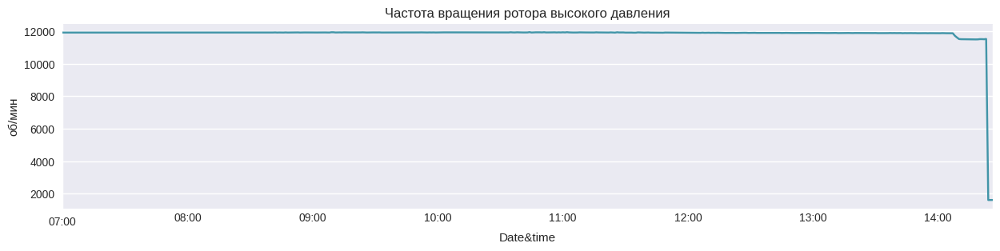

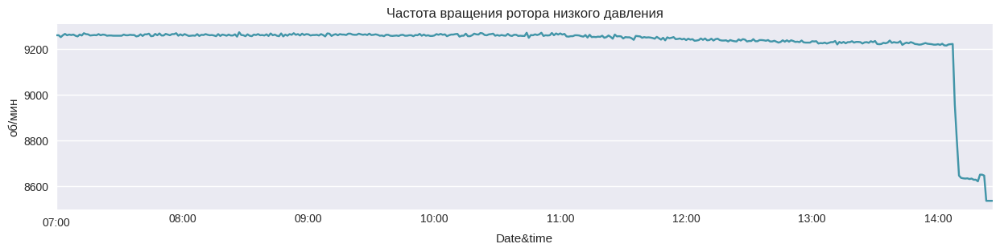

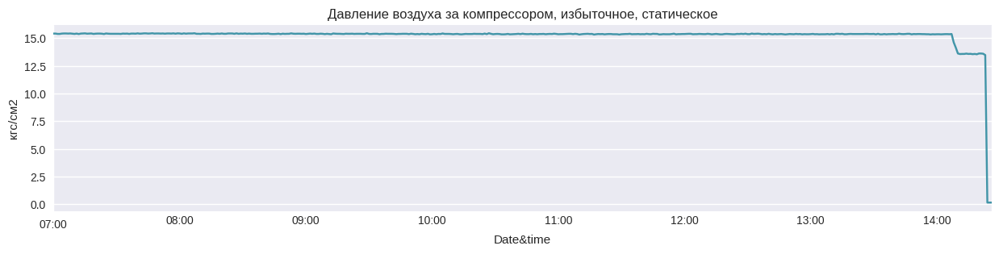

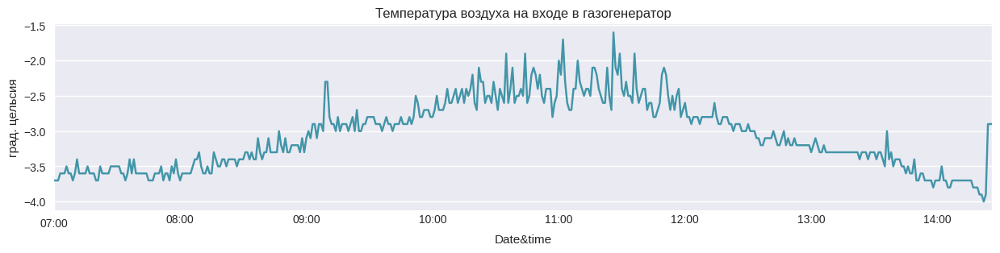

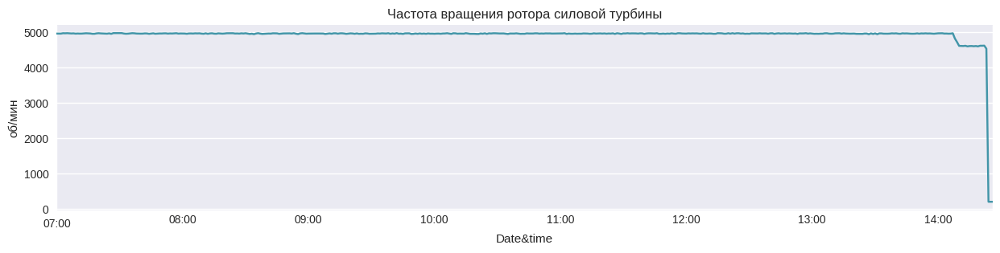

...

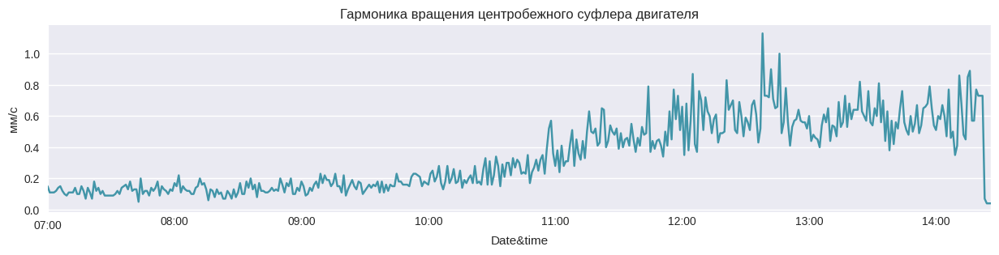

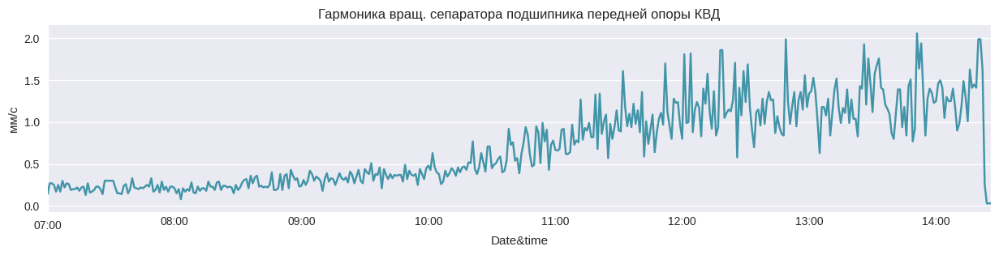

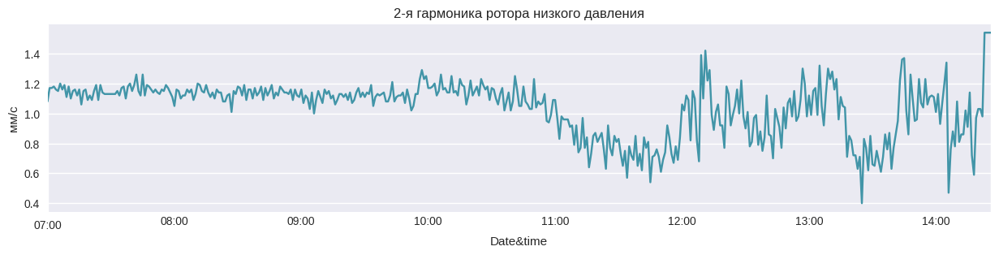

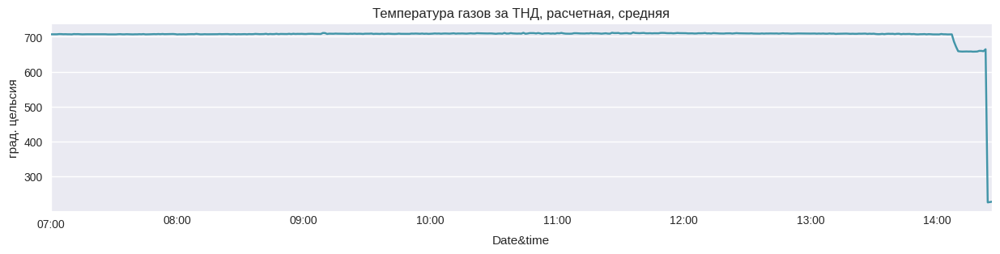

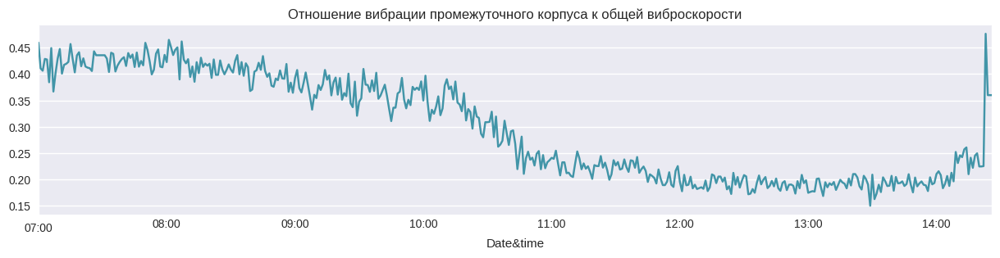

In [12]:
for i in data_cs:
  data_cs[i].plot(figsize=(15, 3), title=anotation_dict[i][0], ylabel=anotation_dict[i][1], color='#4295A8')
  plt.show()
  print()

В ходе визуального и логического анализа графиков были выбраны следующие характеристические признаки:

*   Гармоника вращ. тел кач. подшипника передней опоры КВД
*   Гармоника вращ. сепаратора подшипника передней опоры КВД
*   1-я гармоника ротора высокого давления
*   2-я гармоника ротора высокого давления
*   3-я гармоника ротора высокого давления
*   Гарм. вращ. сепар. подш. задней опоры КНД
*   Гарм. вращ. сепар. подш. передней опоры КНД
*   1-я гармоника ротора низкого давления
*   2-я гармоника ротора низкого давления
*   3-я гармоника ротора низкого давления
*   Температура масла за откачивающим насосом из опоры компрессора
*   Общая (широкополосная) виброскорость корпуса ГГ


Создадим датасет и словарь с анотационными данными, включив в них только выбранные харктеристические признаки

In [15]:
birg_dict = {
    'Fтк4': ['Гармоника вращ. тел кач. подшипника передней опоры КВД', 'мм/с'],
    'Fc4': ['Гармоника вращ. сепаратора подшипника передней опоры КВД', 'мм/с'],
    'F2': ['1-я гармоника ротора высокого давления', 'мм/с'],
    '2F2':['2-я гармоника ротора высокого давления', 'мм/с'],
    '3F2': ['3-я гармоника ротора высокого давления', 'мм/с'],
    'Fc2': ['Гарм. вращ. сепар. подш. задней опоры КНД', 'мм/с'],
    'Fc3': ['Гарм. вращ. сепар. подш. передней опоры КНД', 'мм/с'],
    'F1': ['1-я гармоника ротора низкого давления', 'мм/с'],
    '2F1': ['2-я гармоника ротора низкого давления', 'мм/с'],
    '3F1': ['3-я гармоника ротора низкого давления', 'мм/с'],
    'T638': ['Температура масла за откачивающим насосом из опоры компрессора', 'град. цельсия'],
    'VoГГ':['Общая (широкополосная) виброскорость корпуса ГГ', 'мм/с'],
    'V1/VoГГ': ['Отношение вибрации промежуточного корпуса к общей виброскорости', '']
}

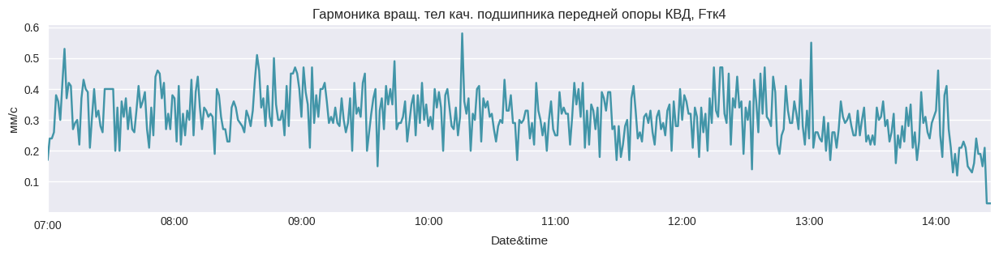

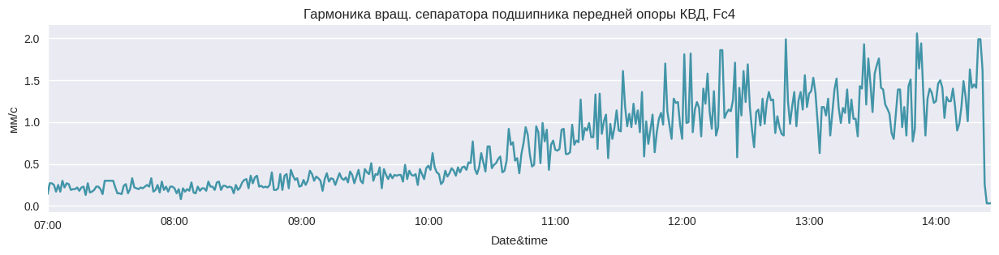

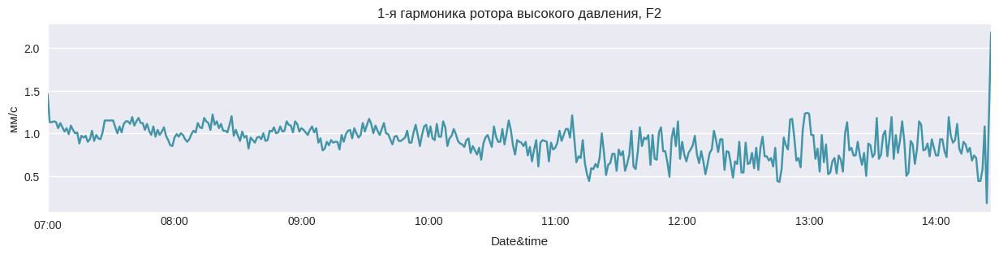

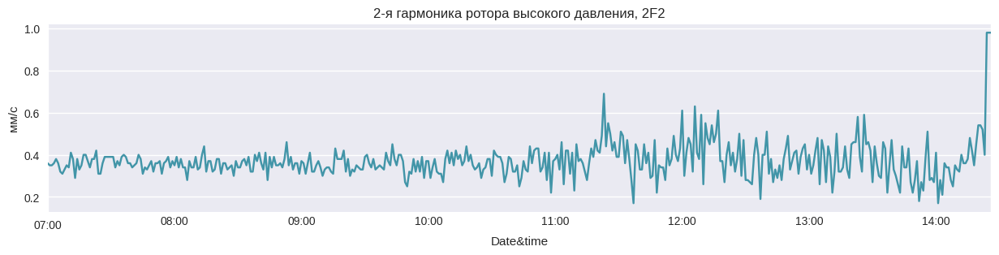

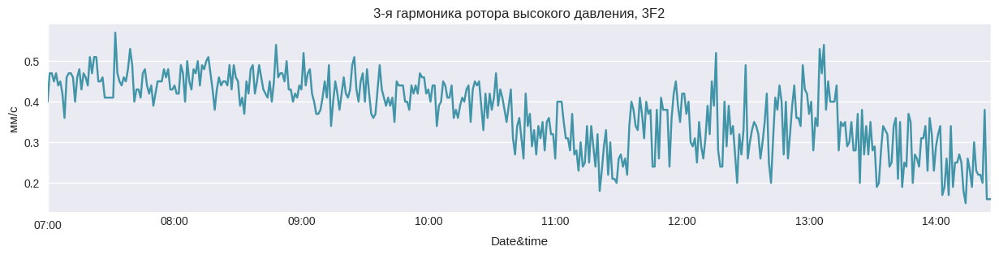

...

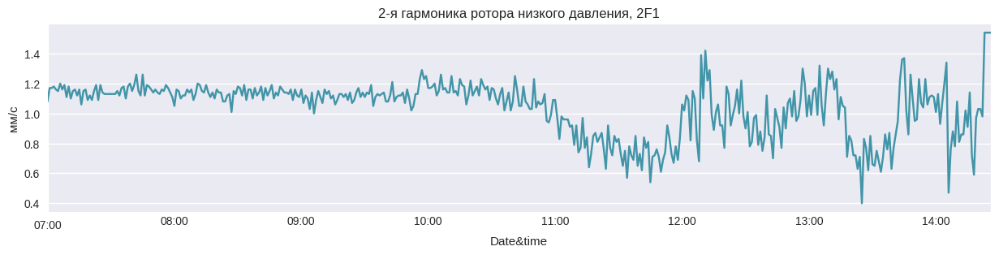

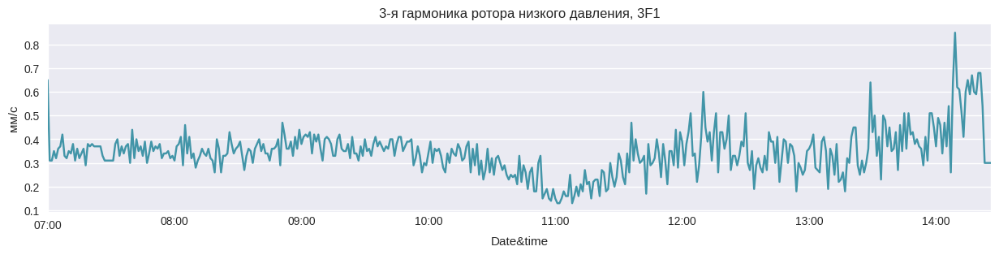

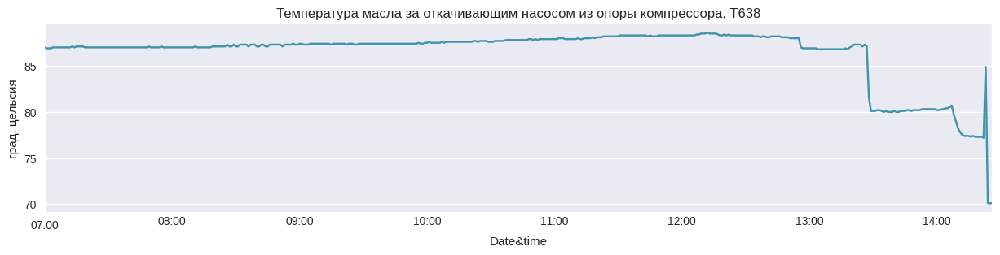

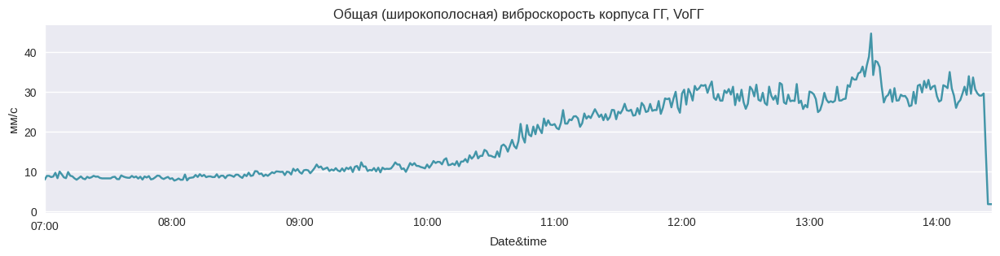

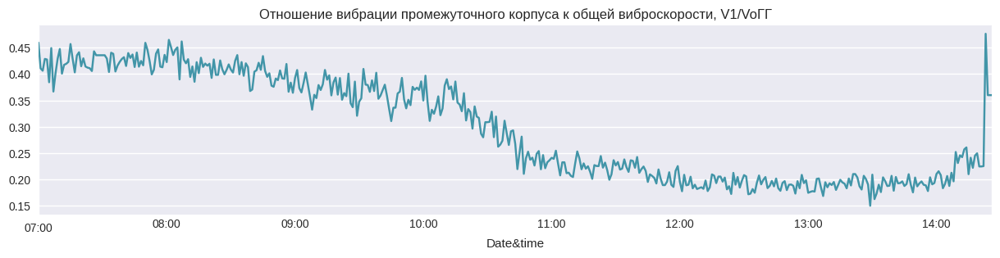

In [16]:
for i in birg_dict:
  data_cs[i].plot(figsize=(15, 3), title=f'{anotation_dict[i][0]}, {i}', ylabel=anotation_dict[i][1], color='#4295A8')
  plt.show()
  print()

In [17]:
correct_data_cs = data_cs[[i for i in birg_dict]]

In [ ]:
correct_data_cs.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 1020 entries, 2022-01-16 06:00:00 to 2022-01-16 22:59:00
Data columns (total 17 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   V1      1020 non-null   float64
 1   VoГГ    1020 non-null   float64
 2   3.77F2  1020 non-null   float64
 3   Fтк4    1020 non-null   float64
 4   3F2     1020 non-null   float64
 5   Tк.з.   1020 non-null   float64
 6   T638    1020 non-null   float64
 7   V2      1020 non-null   float64
 8   dPf1    1020 non-null   float64
 9   Fc2     1020 non-null   float64
 10  F2      1020 non-null   float64
 11  3F1     1020 non-null   float64
 12  Fc3     1020 non-null   float64
 13  2F2     1020 non-null   float64
 14  Fкпа    1020 non-null   float64
 15  Fцс     1020 non-null   float64
 16  Fc4     1020 non-null   float64
dtypes: float64(17)
memory usage: 143.4 KB


Построим графики средних значений на промежутке 10 минут для выбраных характеристических признаков

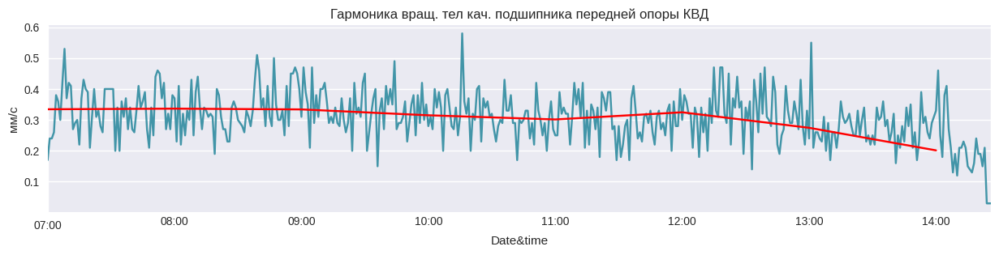

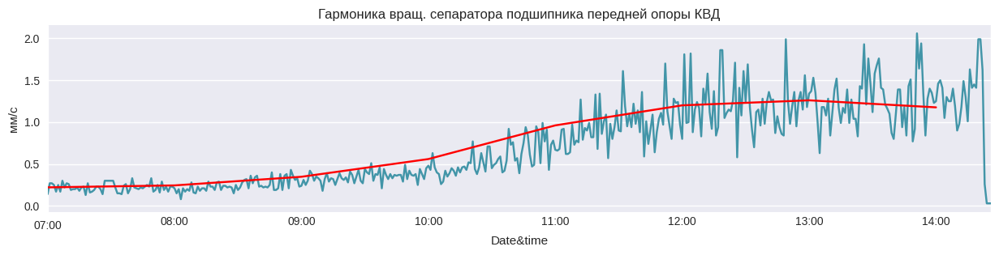

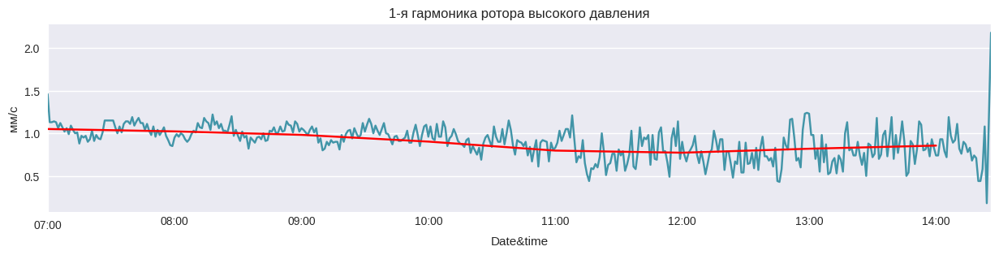

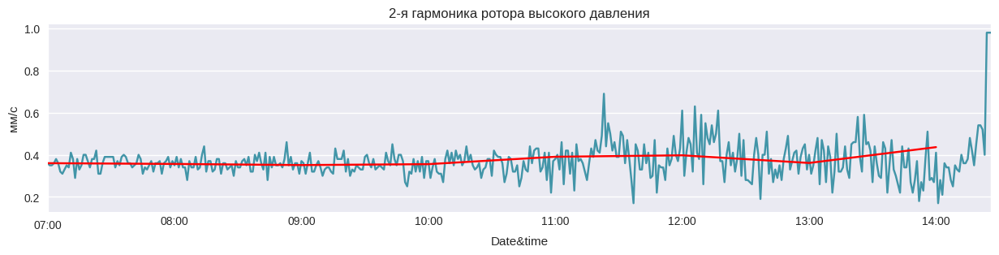

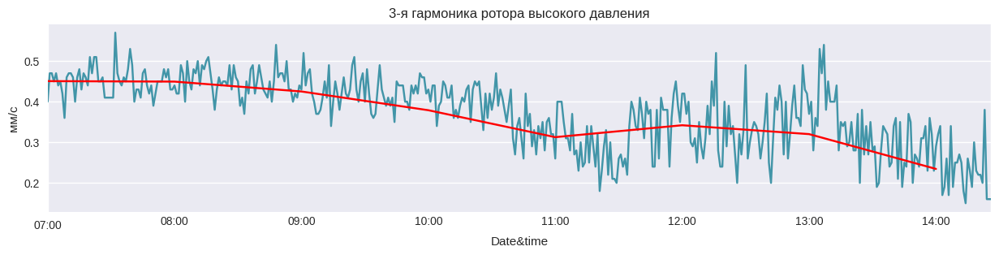

...

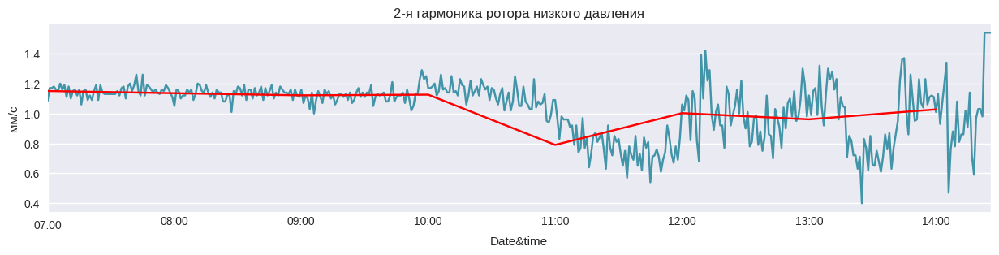

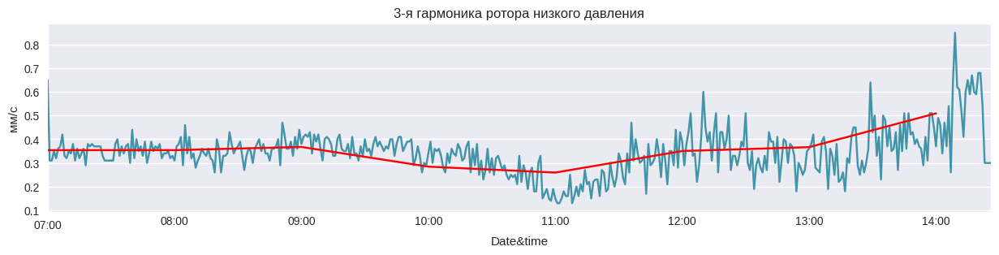

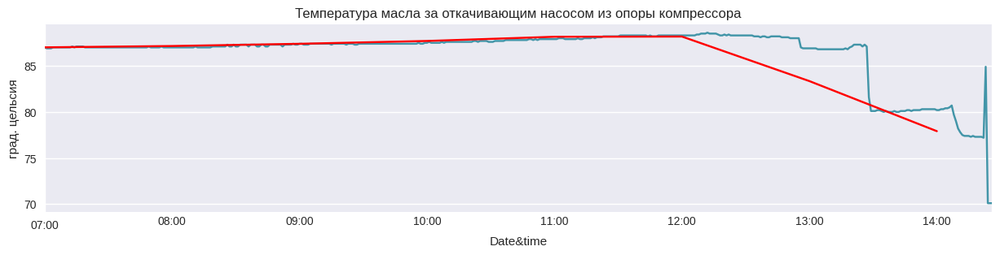

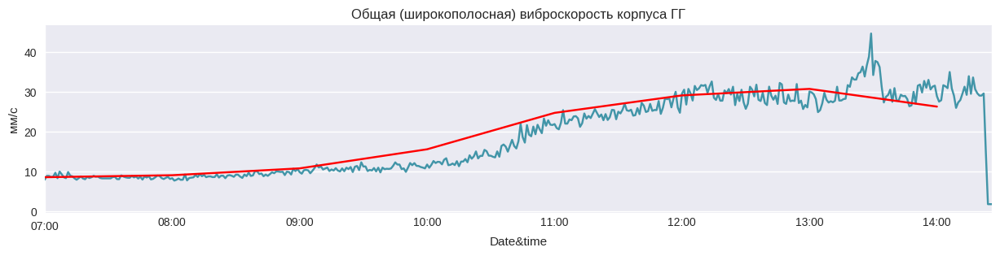

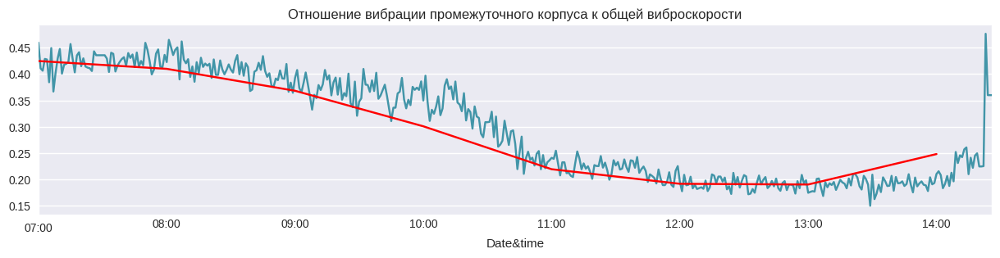

In [19]:
for i in correct_data_cs:
  correct_data_cs[i].plot(figsize=(15, 3), title=birg_dict[i][0], ylabel=birg_dict[i][1], color='#4295A8')
  correct_data_cs[i].resample('h').mean().plot(figsize=(15, 3), title=birg_dict[i][0], ylabel=birg_dict[i][1], color='red')
  plt.show()
  print()


Расширяющееся среднее

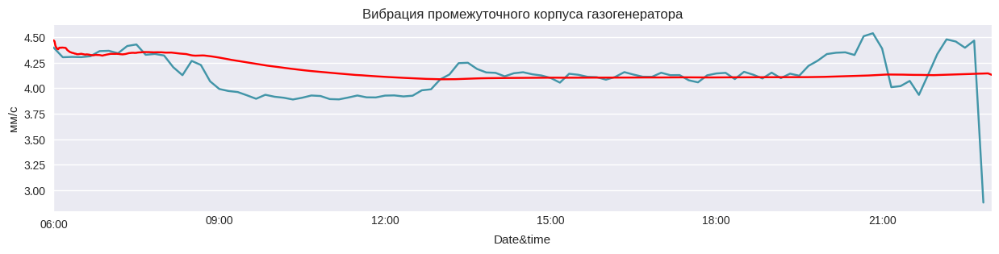

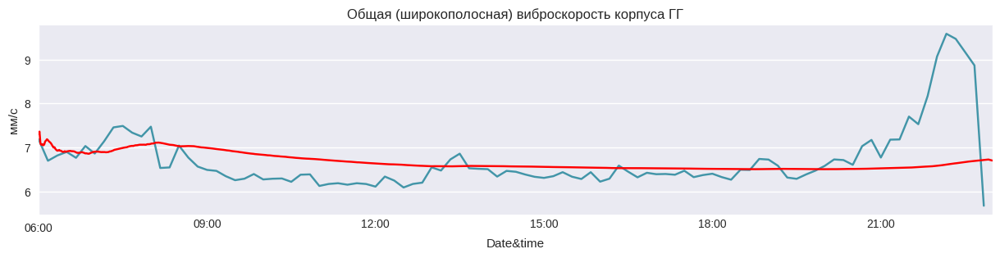

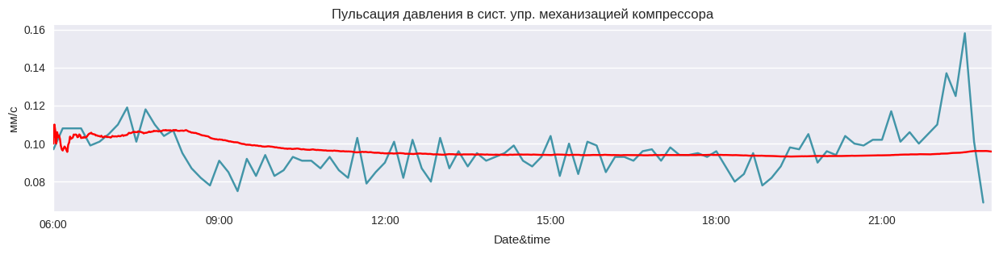

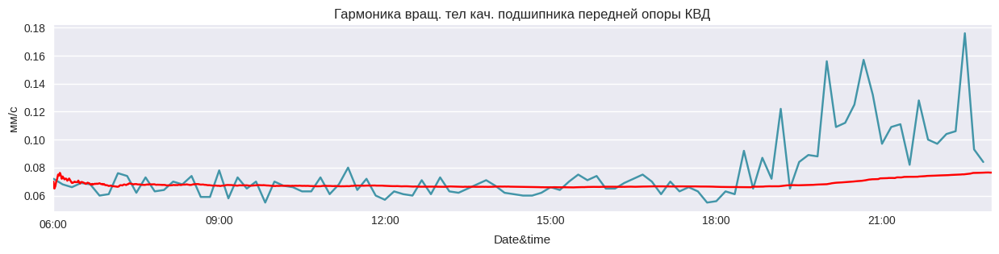

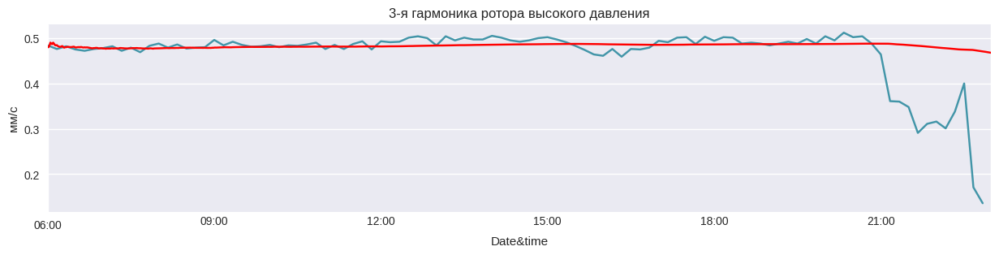

...

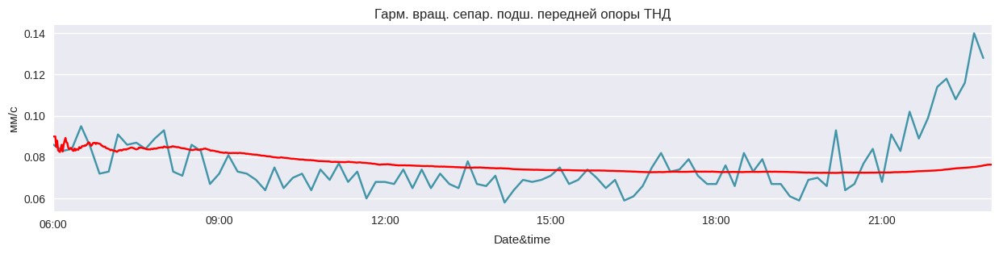

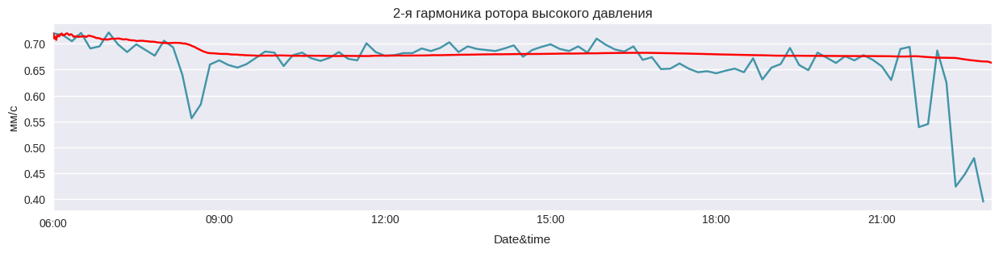

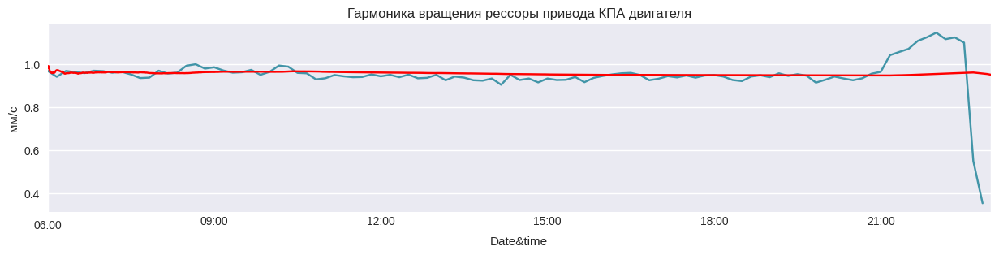

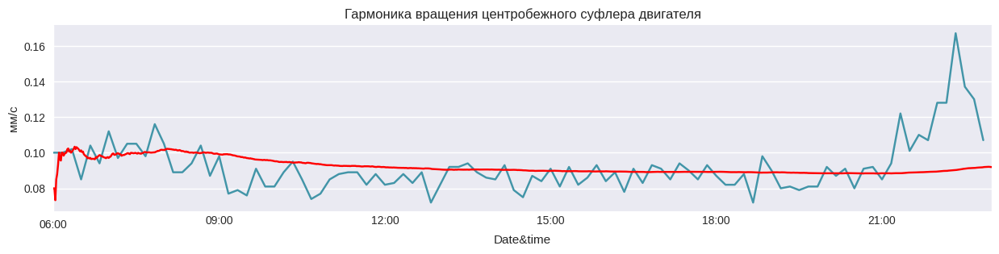

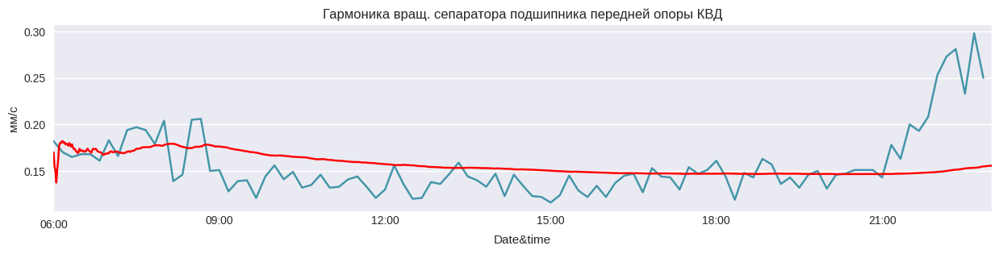

In [ ]:
for i  in correct_data_cs:
  correct_data_cs[i].resample('10min').mean().plot(figsize=(15, 3), title=anotation_dict_correct[i][0], ylabel=anotation_dict_correct[i][1], color='#4295A8')
  correct_data_cs[i].expanding().mean().plot(figsize=(15, 3), title=anotation_dict_correct[i][0], ylabel=anotation_dict_correct[i][1], color='red')
  plt.show()
  print()

Скользящее среднее

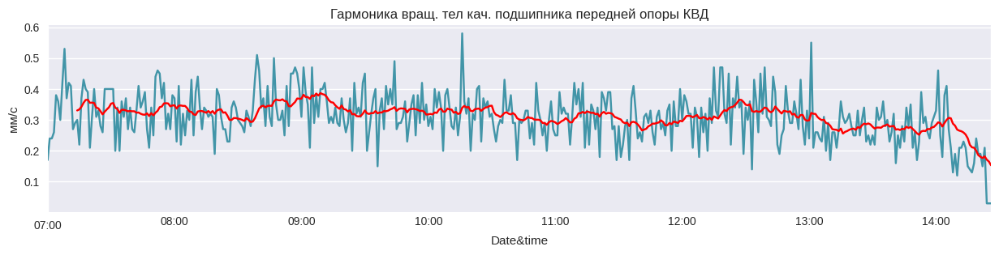

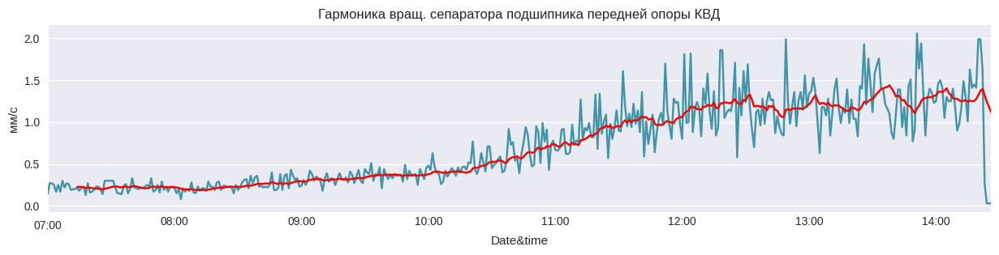

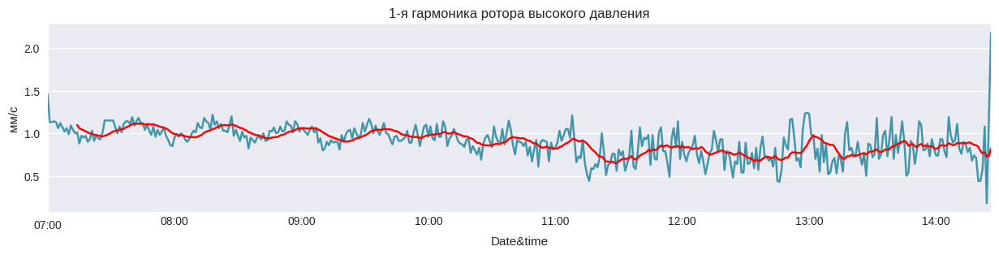

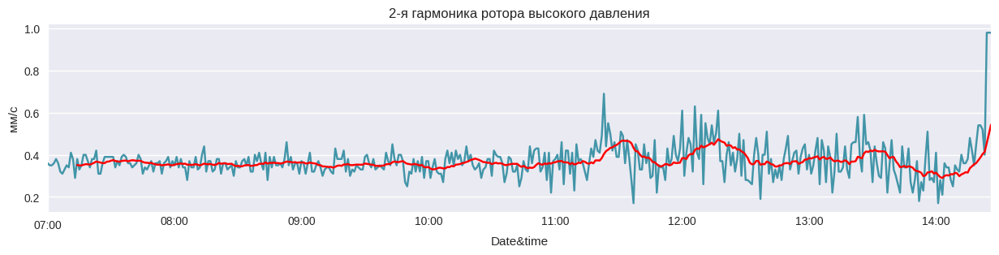

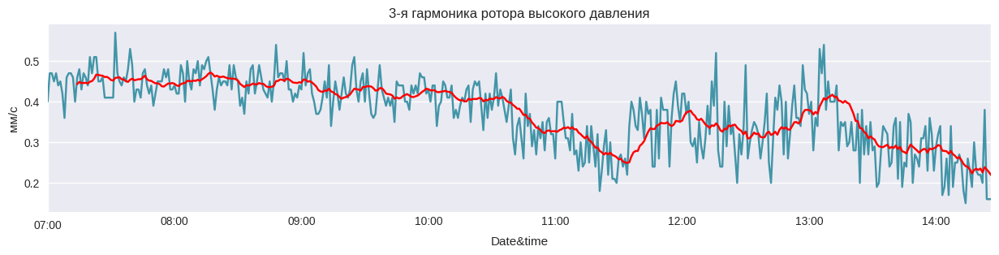

...

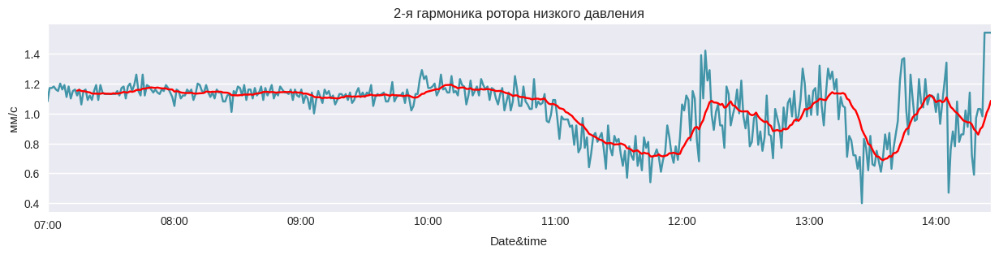

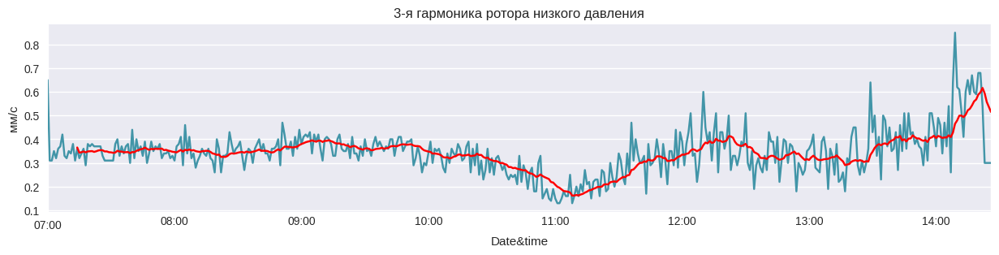

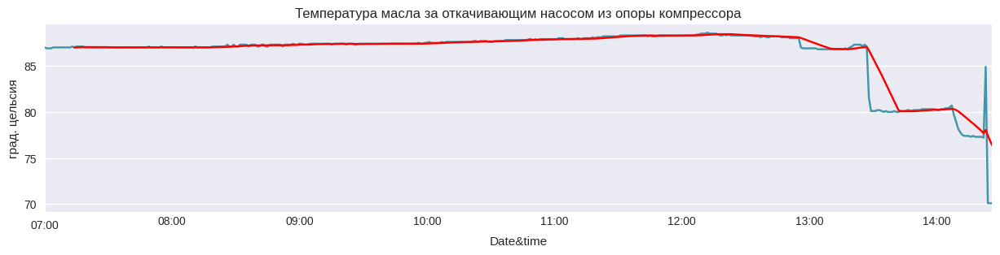

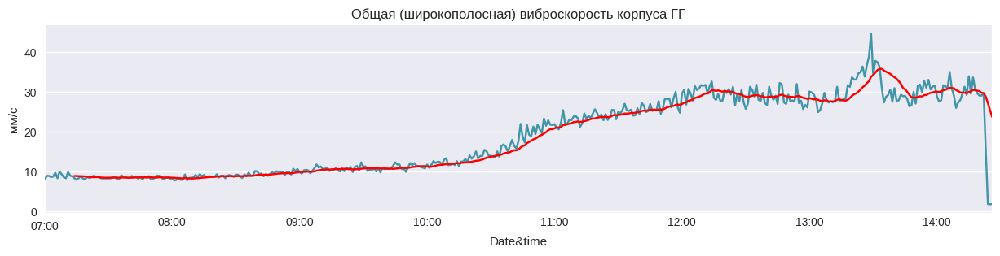

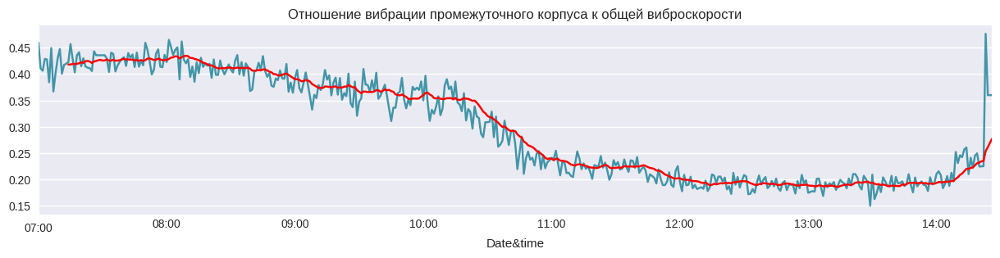

In [21]:
for i  in correct_data_cs:
  correct_data_cs[i].resample('1min').mean().plot(figsize=(15, 3), title=birg_dict[i][0], ylabel=birg_dict[i][1], color='#4295A8')
  correct_data_cs[i].rolling(window=15).mean().plot(figsize=(15, 3), title=birg_dict[i][0], ylabel=birg_dict[i][1], color='red')
  plt.show()
  print()

Построим графики изменения разности значений сдвига

In [23]:
window = 10
for i in correct_data_cs:
  f = correct_data_cs[i]
  roll_mean_past = f.rolling(window=window).mean().shift(10)
  df_deltaroll = pd.DataFrame({
      birg_dict[i][0] : f,
      'roll_mean_past' : roll_mean_past,
      'delta' : f - roll_mean_past
  })

  print(df_deltaroll.tail(60))
  print()

  #(f - roll_mean_past).plot(figsize=(15, 3), title=anotation_dict_correct[i][0], ylabel=anotation_dict_correct[i][1], color='#4295A8')

  #plt.show()
  #print()

                     Гармоника вращ. тел кач. подшипника передней опоры КВД  roll_mean_past  delta
Date&time                                                                                         
2021-05-01 13:27:00                                               0.23                0.262 -0.032
2021-05-01 13:28:00                                               0.25                0.272 -0.022
2021-05-01 13:29:00                                               0.22                0.275 -0.055
2021-05-01 13:30:00                                               0.25                0.286 -0.036
2021-05-01 13:31:00                                               0.22                0.285 -0.065
2021-05-01 13:32:00                                               0.34                0.284  0.056
2021-05-01 13:33:00                                               0.30                0.296  0.004
2021-05-01 13:34:00                                               0.31                0.294  0.016
2021-05-01

Разложим выбранные временные ряды на составляющие

In [24]:
# импортируем функцию seasonal_decompose из statsmodels
from statsmodels.tsa.seasonal import seasonal_decompose

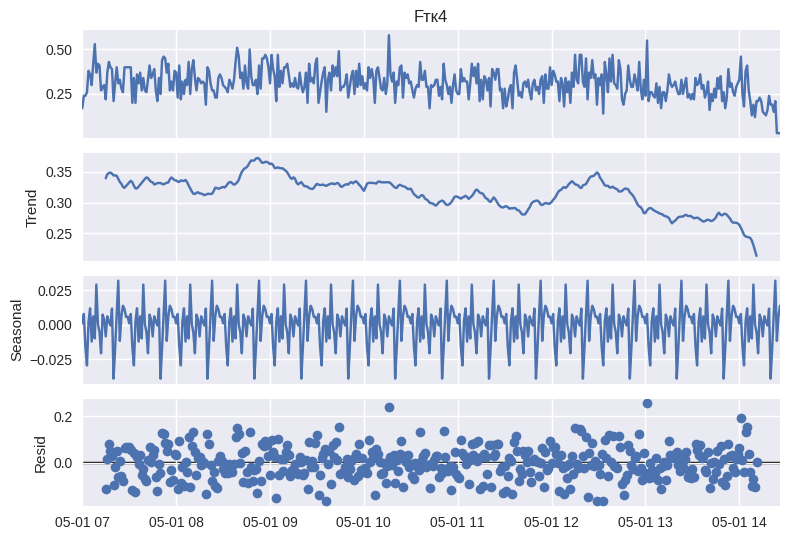

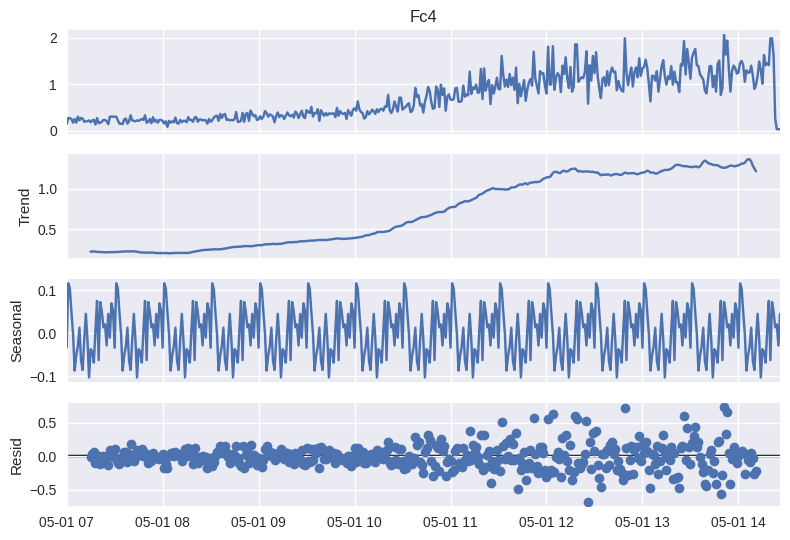

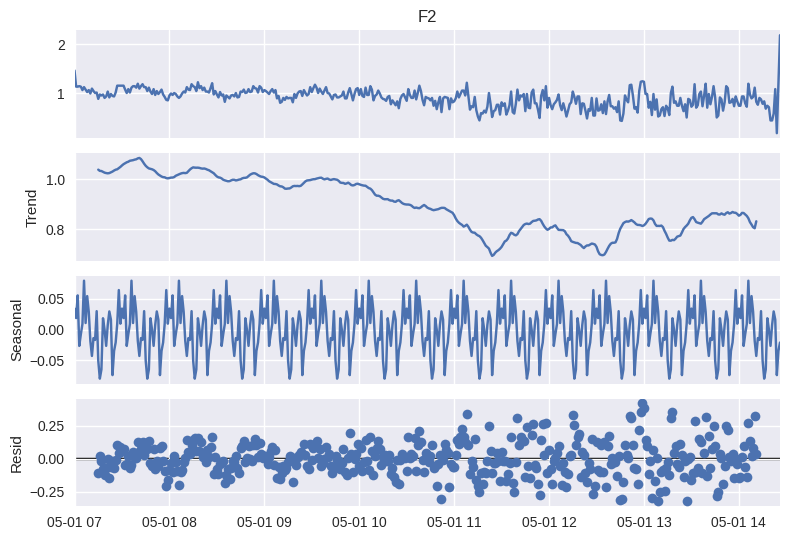

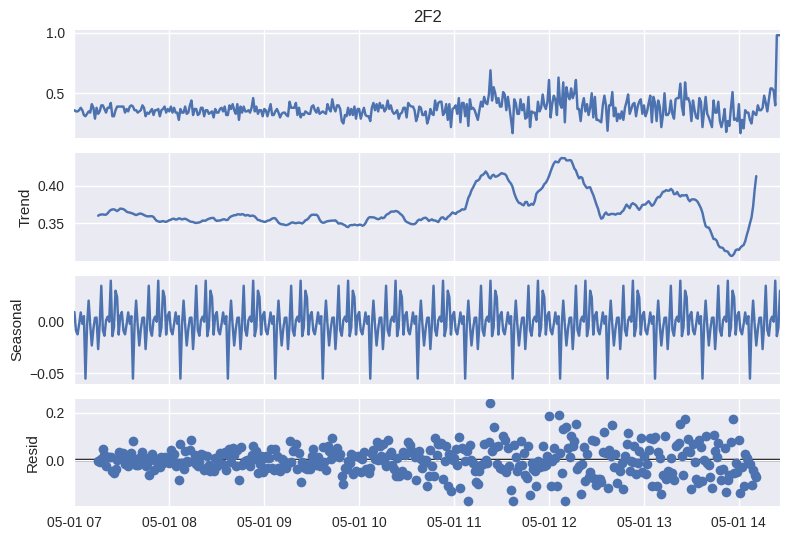

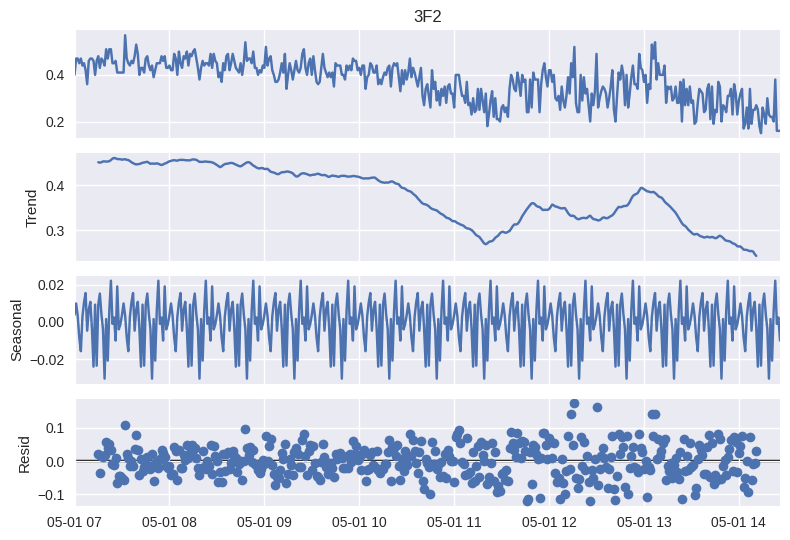

...

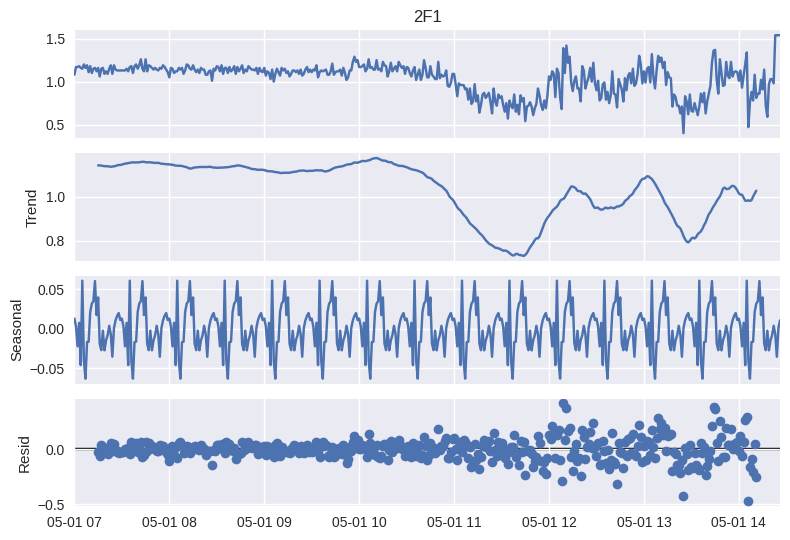

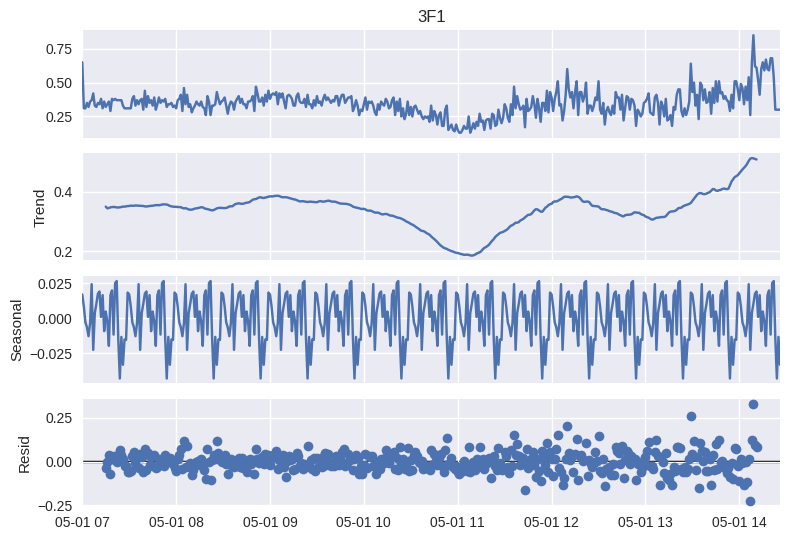

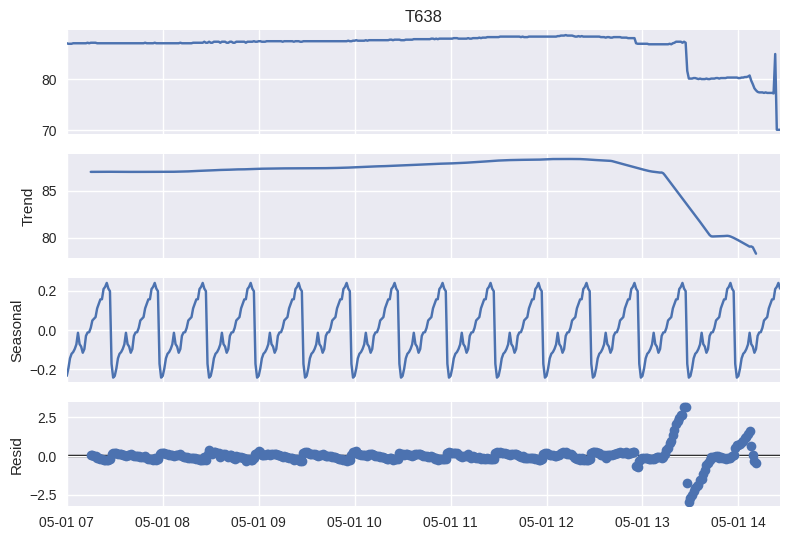

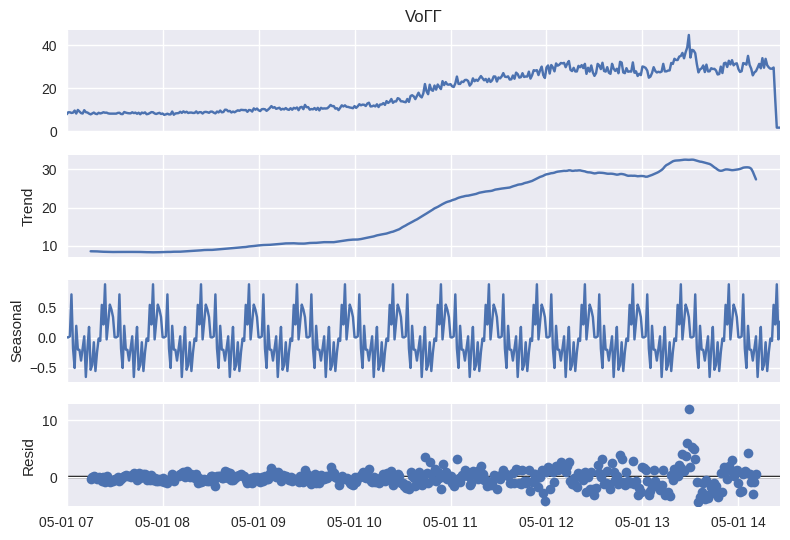

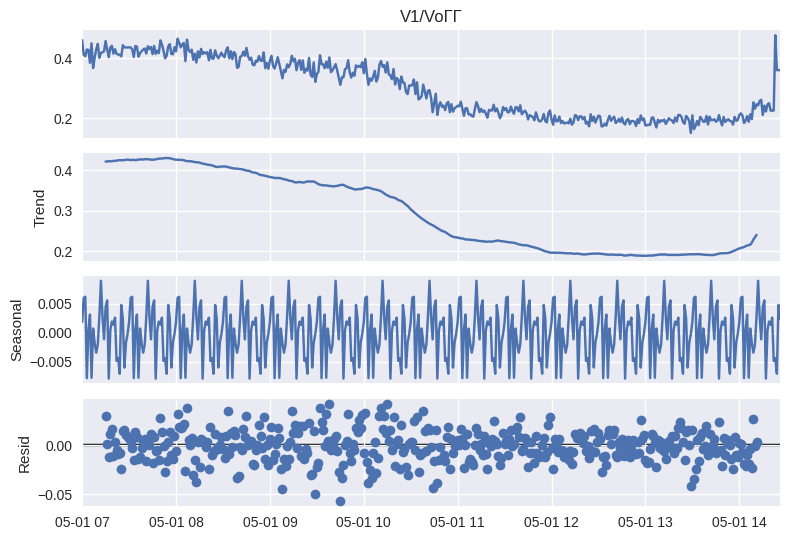

In [25]:
for i in correct_data_cs:
  y = correct_data_cs[i]
  decompose = seasonal_decompose(y, model='additive', period=30)  # например, 60 минут
  decompose.plot()
  plt.show()
  print()

Проведем анализ выбранных временых рядов на стационарность

In [27]:
for i in correct_data_cs:
  adf_test = adfuller(correct_data_cs[i])
  if adf_test[1] < 0.05:
    print(f'\u25CF {birg_dict[i][0]} - стационарный ряд ✅, p-value = {adf_test[1]}')
  else:
    print(f'\u25CF {birg_dict[i][0]} - нестационарный ряд ❌, p-value = {adf_test[1]}')

● Гармоника вращ. тел кач. подшипника передней опоры КВД - стационарный ряд ✅, p-value = 0.01724234514302517
● Гармоника вращ. сепаратора подшипника передней опоры КВД - нестационарный ряд ❌, p-value = 0.7499904454311032
● 1-я гармоника ротора высокого давления - стационарный ряд ✅, p-value = 0.006212307759694207
● 2-я гармоника ротора высокого давления - нестационарный ряд ❌, p-value = 0.4245025356357438
● 3-я гармоника ротора высокого давления - нестационарный ряд ❌, p-value = 0.8310327140736231
● Гарм. вращ. сепар. подш. задней опоры КНД - нестационарный ряд ❌, p-value = 0.39708527253398757
● Гарм. вращ. сепар. подш. передней опоры КНД - нестационарный ряд ❌, p-value = 0.9577339453846456
● 1-я гармоника ротора низкого давления - нестационарный ряд ❌, p-value = 0.5979692736196152
● 2-я гармоника ротора низкого давления - стационарный ряд ✅, p-value = 0.022832333899282527
● 3-я гармоника ротора низкого давления - нестационарный ряд ❌, p-value = 0.1632820120284752
● Температура масла з

проведенный анализ стационраности наводит на мысль использования одинарного дифференцирования

In [28]:
for i in correct_data_cs:
  adf_test = adfuller(correct_data_cs[i].diff().dropna())
  if adf_test[1] < 0.05:
    print(f'\u25CF {birg_dict[i][0]} - стационарный ряд ✅, p-value = {adf_test[1]}')
  else:
    print(f'\u25CF {birg_dict[i][0]} - нестационарный ряд ❌, p-value = {adf_test[1]}')

● Гармоника вращ. тел кач. подшипника передней опоры КВД - стационарный ряд ✅, p-value = 8.167152758819345e-14
● Гармоника вращ. сепаратора подшипника передней опоры КВД - стационарный ряд ✅, p-value = 1.1634456547698796e-12
● 1-я гармоника ротора высокого давления - стационарный ряд ✅, p-value = 3.578972522850994e-12
● 2-я гармоника ротора высокого давления - стационарный ряд ✅, p-value = 0.004171656300256465
● 3-я гармоника ротора высокого давления - стационарный ряд ✅, p-value = 1.9730212377974905e-12
● Гарм. вращ. сепар. подш. задней опоры КНД - стационарный ряд ✅, p-value = 1.2374465946204262e-25
● Гарм. вращ. сепар. подш. передней опоры КНД - стационарный ряд ✅, p-value = 3.65134292273212e-14
● 1-я гармоника ротора низкого давления - нестационарный ряд ❌, p-value = 0.9811651013360054
● 2-я гармоника ротора низкого давления - стационарный ряд ✅, p-value = 1.2801933680557386e-27
● 3-я гармоника ротора низкого давления - стационарный ряд ✅, p-value = 3.262374686646557e-18
● Температ

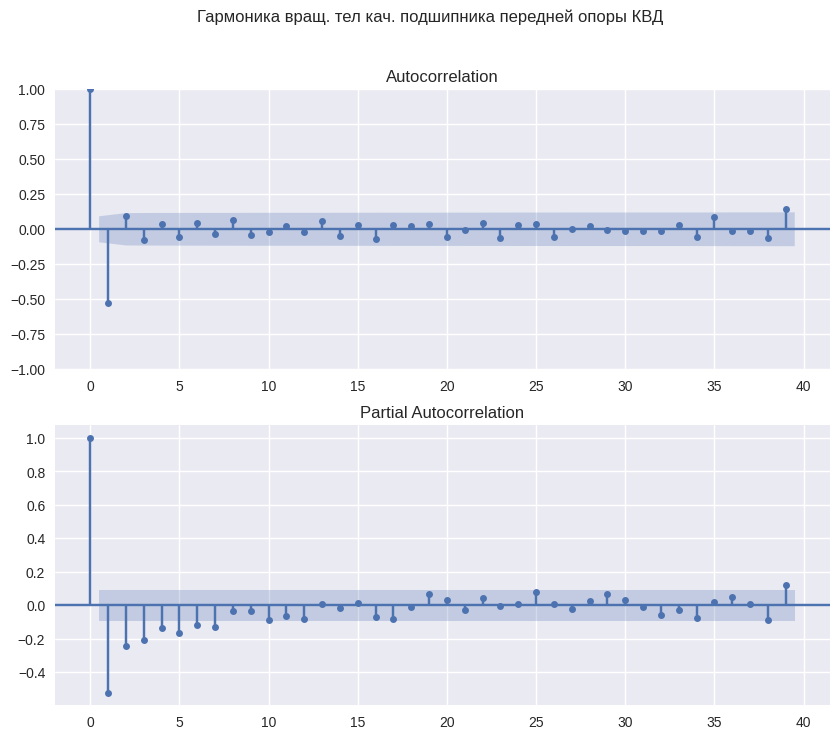

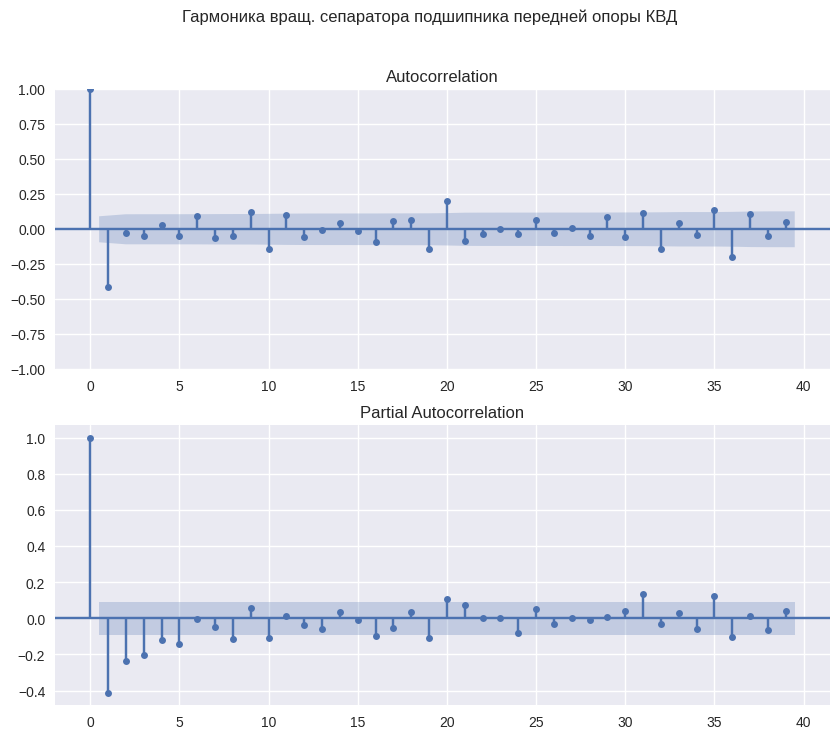

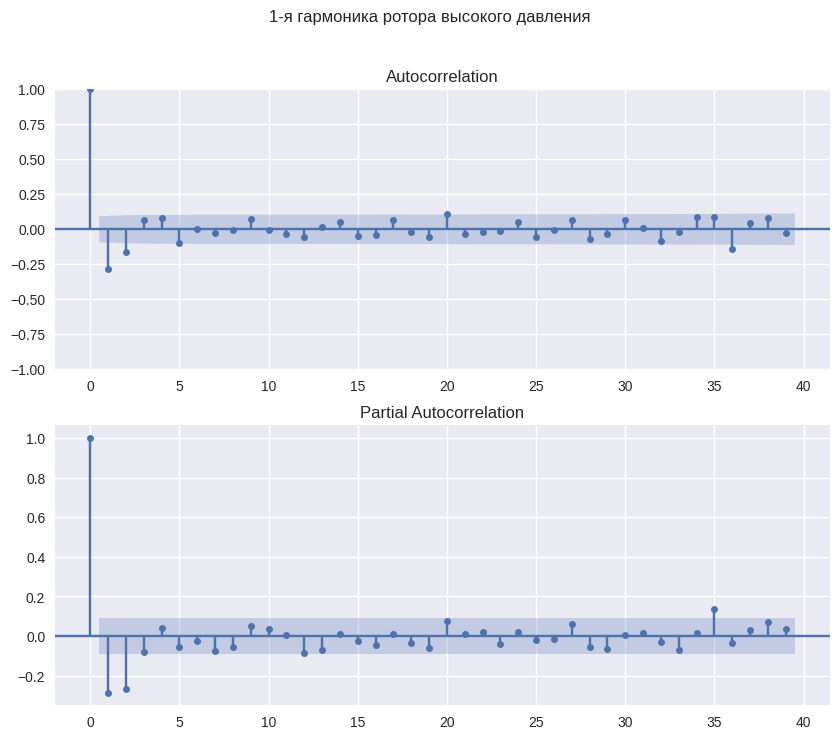

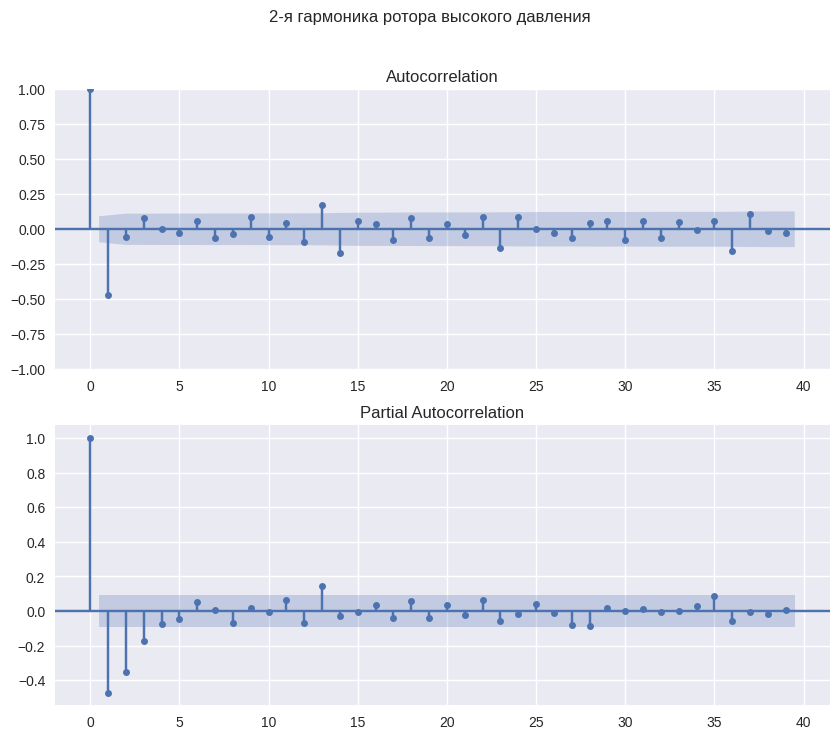

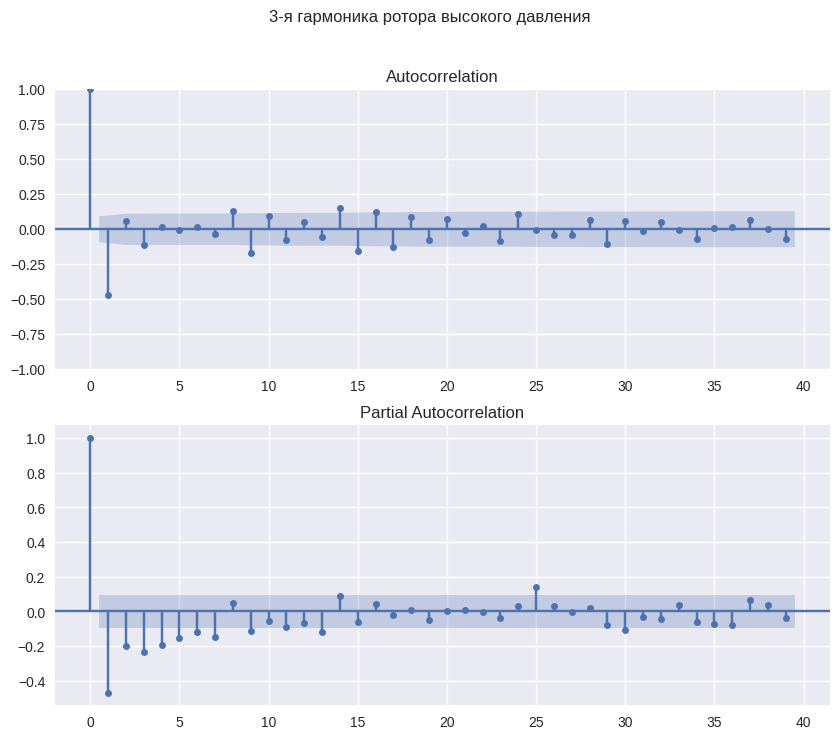

...

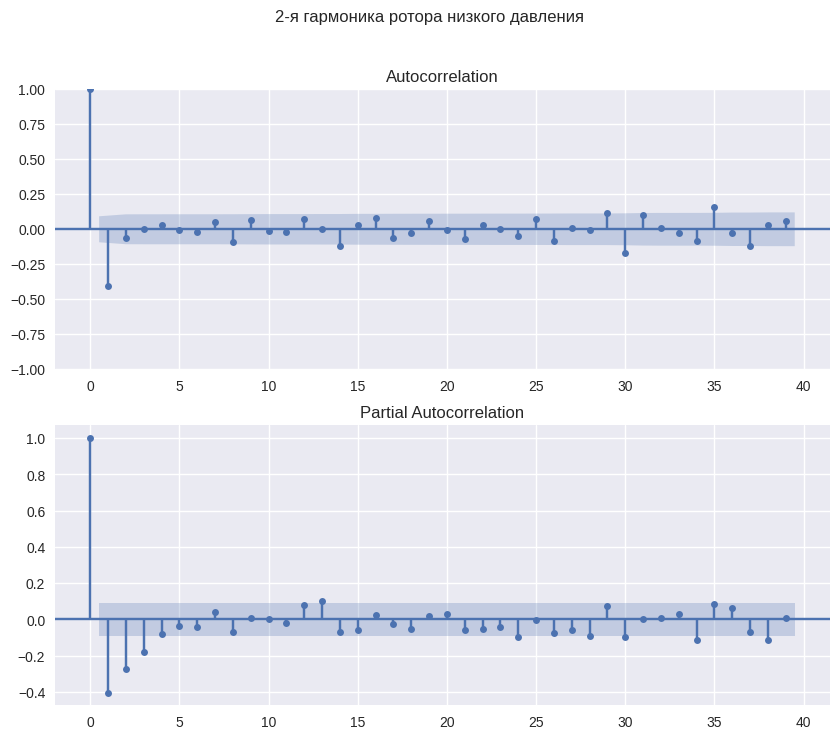

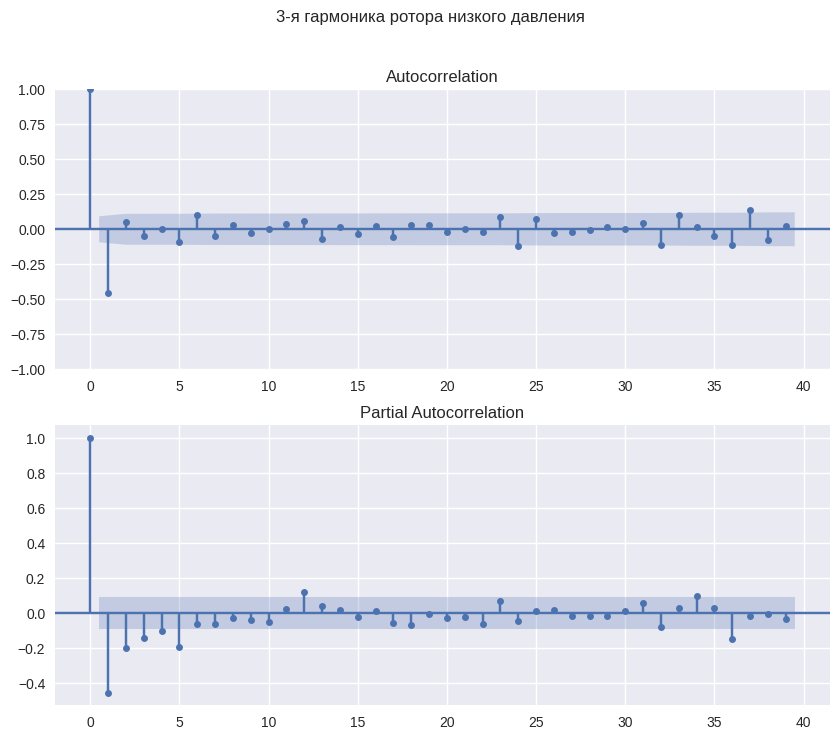

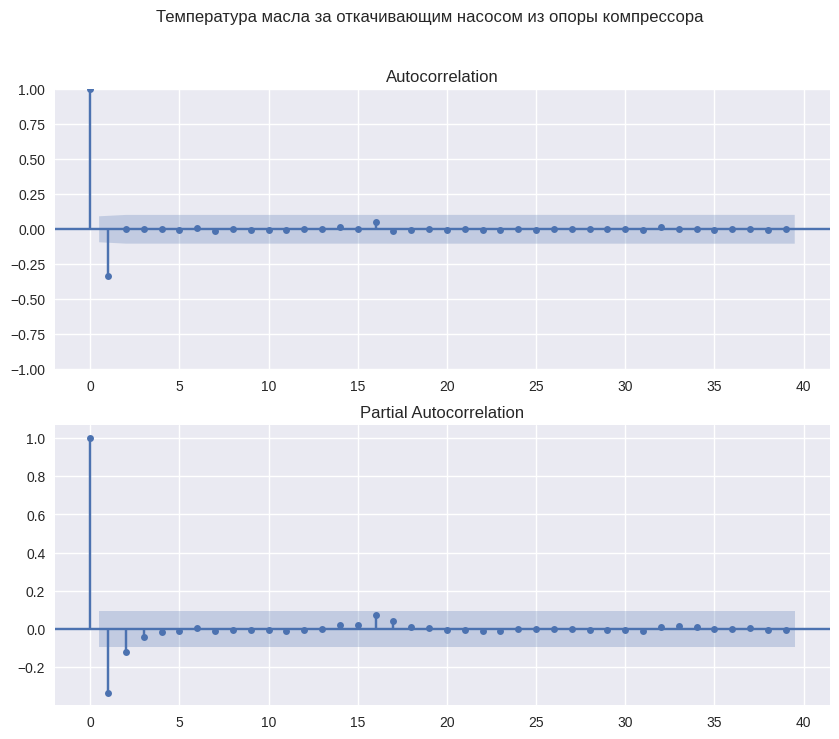

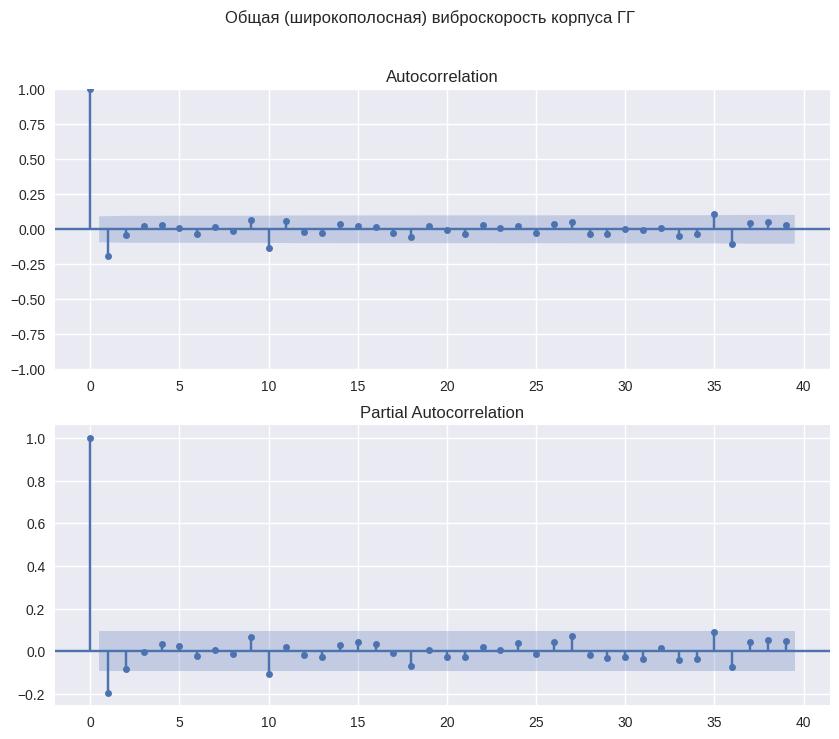

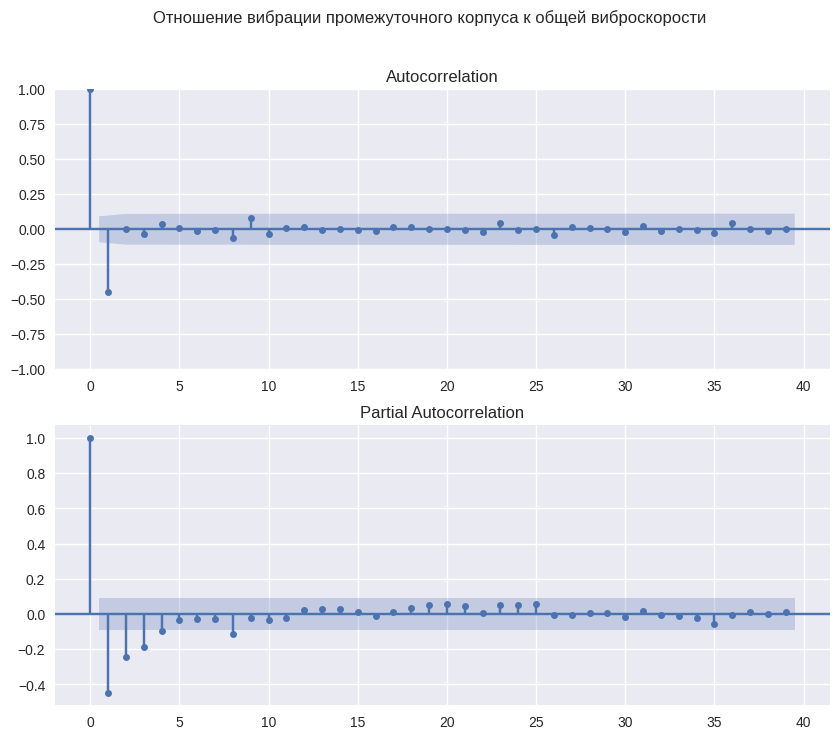

In [30]:
for i in correct_data_cs:
  fig, axes = plt.subplots(2, 1, figsize=(10, 8))
  plot_acf(correct_data_cs[i].diff().dropna(), ax=axes[0], lags = np.arange(40))
  plot_pacf(correct_data_cs[i].diff().dropna(), ax=axes[1], lags = np.arange(40))
  plt.axis('tight')
  fig.suptitle(birg_dict[i][0])
  plt.show()
  print()

Проведем разверточный анализ

In [31]:
!pip install ydata-profiling -U -q

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 400.4/400.4 kB 28.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.7/296.7 kB 23.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.1/3.1 MB 64.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 679.7/679.7 kB 32.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 105.4/105.4 kB 9.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 65.9/65.9 kB 4.9 MB/s eta 0:00:00


In [32]:
from ydata_profiling import ProfileReport

In [34]:
# YData Profiling
profile = ProfileReport(correct_data_cs, title="Отчет", explorative=True)
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]


100%|██████████| 13/13 [00:00<00:00, 86.47it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]